# 0.0 IMPORTS

In [729]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn import preprocessing as pp
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model  import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from boruta import BorutaPy
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error
import plotly.graph_objects as go
warnings.filterwarnings('ignore')

## 0.1 Helper Functions

In [730]:
def jupyter_settings():
    %matplotlib inline
    %pylab inline
    
    plt.style.use('bmh')
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
        
    sns.set()

def ml_error(model_name, y, yhat):
    mae  = mean_absolute_error(y, yhat) 
    mape = mean_absolute_percentage_error(y, yhat)
    rmse = np.sqrt(mean_squared_error(y, yhat))
    
    return pd.DataFrame({'Model Name': model_name,
                         'MAE': mae,
                         'MAPE': mape,
                         'RMSE': rmse}, index = [0])

layout = go.Layout(autosize=False, width=800, height=250,
                   margin=go.layout.Margin(l=10, r=10, b=10, t=10, pad = 6))

In [731]:
jupyter_settings()

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


## 0.2 Loading Data

In [732]:
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\Clima_NASA.csv')

df_aux.rename(columns={'MO':'MONTH',
                      'DY': 'DAY',
                      'HR': 'HOUR',
                      'CLRSKY_SFC_SW_DWN': 'CLRSKY_SW[Wh/m^2]',
                      'ALLSKY_SFC_SW_DWN': 'ALLSKY_SW[Wh/m^2]',
                      'ALLSKY_SFC_UVA': 'UVA[W/m^2]',
                      'ALLSKY_SFC_UVB': 'UVB[W/m^2]',
                      'T2M': 'T2M[C]',
                      'T2MDEW': 'T2MDEW[C]',
                      'QV2M': 'QV2M[g/kg]',
                      'RH2M': 'RH2M[%]',
                      'PRECTOTCORR':'PREC[mm/hour]',
                      'PS': 'PS[kPa]',
                      'WS10M': 'WS10M[m/s]',
                      'WD10M': 'WD10M[deg]'
                      },
                      inplace=True)
df_aux['TIME'] = pd.to_datetime(df_aux[['YEAR', 'MONTH', 'DAY', 'HOUR']], format='%Y-%m-%d %H:%M:%S')
df_aux.drop(columns=['YEAR', 'MONTH', 'DAY', 'HOUR'], inplace=True)
df_aux['Date'] = pd.to_datetime(df_aux['TIME'].dt.date)
dfWeather = df_aux
dfWeather.head()
dfWeather.to_csv('dfWeather.csv', index=False)


In [733]:
def clean_data(df):
        df.drop(['Number'], axis=1, inplace=True)
        df.head()

        cols = ['Time', 'DC Power PvPV1(W)', 'DC Power PvPV2(W)', 'DC Power PvPV3(W)', 'DC Power PvPV4(W)', 'Total Inverter Power(W)', 'Today Yield(kWh)', 'Total Yield(kWh)', 'IGBT  Temperature(℃)']

        df = df[cols]
        df['DC Total Power'] = df['DC Power PvPV1(W)'] + df['DC Power PvPV2(W)'] + df['DC Power PvPV3(W)']
        df.drop(['DC Power PvPV1(W)', 'DC Power PvPV2(W)', 'DC Power PvPV3(W)', 'DC Power PvPV4(W)'], axis=1, inplace=True)	
        df['Time'] = df['Time'].str.replace(' (UTC-4:00)', '')
        df['Time'] = pd.to_datetime(df['Time'], dayfirst=True)
        df['Date'] = pd.to_datetime(df['Time'].dt.date)


        return df

In [734]:
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\41.1_processed.csv')
dfPower41 = clean_data(df_aux)
dfPower41['Inverter'] = '054B7020C020041'
dfPower41.to_csv('dfPower41.csv', index=False)


In [735]:
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\42.1_processed.csv')
dfPower42 = clean_data(df_aux)
dfPower42['Inverter'] = '054B7020C020042'
dfPower42.to_csv('dfPower42.csv', index=False)


In [736]:
df_aux = pd.read_csv(r'C:\Users\Artem\tcc_fotovoltaica_camp\datasets\campinas\44.1_processed.csv')
dfPower44 = clean_data(df_aux)
dfPower44['Inverter'] = '054B7020C020044'
dfPower44.to_csv('dfPower44.csv', index=False)


In [737]:
dfPower44.head()

,Time,Total Inverter Power(W),Today Yield(kWh),Total Yield(kWh),IGBT Temperature(℃),DC Total Power,Date,Inverter
0,2022-12-21 04:16:19,20.0,0.0,18990.0,24.5,30,2022-12-21,054B7020C020044
1,2022-12-21 04:21:19,20.0,0.0,18990.0,25.0,85,2022-12-21,054B7020C020044
2,2022-12-21 04:26:19,20.0,0.0,18990.0,25.6,90,2022-12-21,054B7020C020044
3,2022-12-21 04:31:22,20.0,0.0,18990.0,26.0,90,2022-12-21,054B7020C020044
4,2022-12-21 04:36:27,40.0,0.0,18990.0,26.5,93,2022-12-21,054B7020C020044


In [738]:
dfPower = pd.concat([dfPower41, dfPower42, dfPower44], ignore_index=True)
dfPower = dfPower.sort_values(by=['Time'])
dfPower.reset_index(inplace=True)
dfPower.drop(columns=['index'], inplace=True, axis=1)

In [739]:
# Certifique-se de que 'Date' é do tipo datetime
dfPower['Date'] = pd.to_datetime(dfPower['Date'])
dfWeather['Date'] = pd.to_datetime(dfWeather['Date'])


In [740]:

# Crie uma nova coluna 'DateTime' combinando 'Date' e 'Time'/'TIME'
dfPower['DateTime'] = dfPower['Date'] + pd.to_timedelta(dfPower['Time'].dt.hour, unit='h')
dfWeather['DateTime'] = dfWeather['Date'] + pd.to_timedelta(dfWeather['TIME'].dt.hour, unit='h')


In [741]:

# Mescle os dois dataframes em 'DateTime'
df = pd.merge(dfPower, dfWeather, on='DateTime')


In [742]:

# Exclua as colunas desnecessárias
df.drop(['Date_x', 'Time', 'Date_y', 'TIME'], axis=1, inplace=True)


In [743]:
# # Renomeie as colunas
# df.rename(columns={'DateTime': 'DateTime',
#                     'Total Inverter Power(W)': 'ACPOWER[W]',
#                     'Today Yield(kWh)': 'TODAYY[kWh]',
#                     'Total Yield(kWh)': 'TOTALY[kWh]',
#                     'IGBT  Temperature(℃)': 'IGBT[C]',
#                     'DC Total Power': 'DCPOWER[W]',
#                     'Inverter': 'INVERTER'}, inplace=True)
df.rename(columns={'Time': 'TIME',
                    'Total Inverter Power(W)': 'ACPOWER[W]',
                    'Today Yield(kWh)': 'TODAYY[kWh]',
                    'Total Yield(kWh)': 'TOTALY[kWh]',
                    'IGBT  Temperature(℃)': 'IGBT[C]',
                    'DC Total Power': 'DCPOWER[W]',
                    'Inverter': 'INVERTER'},
                    inplace=True)
print(df.shape)
df.head()

(172161, 28)


,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,UVA[W/m^2],UVB[W/m^2],ALLSKY_SFC_UV_INDEX,RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg],WS50M,WD50M
0,20.0,0.0,18898.0,25.2,39,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
1,20.0,0.0,18990.0,24.5,30,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
2,20.0,0.0,17510.0,25.6,30,054B7020C020041,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
3,20.0,0.0,18898.0,25.5,84,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
4,20.0,0.0,18990.0,25.0,85,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74


In [744]:
# Salve o DataFrame em um arquivo CSV
df.to_csv('mesclando_datas.csv', index=False)

df.head()


,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,UVA[W/m^2],UVB[W/m^2],ALLSKY_SFC_UV_INDEX,RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg],WS50M,WD50M
0,20.0,0.0,18898.0,25.2,39,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
1,20.0,0.0,18990.0,24.5,30,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
2,20.0,0.0,17510.0,25.6,30,054B7020C020041,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
3,20.0,0.0,18898.0,25.5,84,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74
4,20.0,0.0,18990.0,25.0,85,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,0.0,0.0,0.0,96.5,0.03,92.56,3.86,154.94,6.3,154.74


In [745]:
# Alinhe os DataFrames por rótulo da coluna 'Time' preenchendo com zeros
aligned_df = dfPower44[['Time', 'Total Inverter Power(W)']].align(dfPower42[['Time', 'Total Inverter Power(W)']], axis=0, fill_value=0)


In [746]:
# Extraia os DataFrames alinhados da tupla
dfLeft, dfRight = aligned_df

In [747]:
# Some as colunas 'Total Inverter Power(W)' por linha
dfAcPowerT = dfLeft['Total Inverter Power(W)'] + dfRight['Total Inverter Power(W)']


In [748]:
# Some a potência de dfPower41
dfAcPowerT += dfPower41['Total Inverter Power(W)']
# Salve o DataFrame em um arquivo CSV
dfAcPowerT.to_csv('mesclando_PowerT.csv', index=False)

# 1.0 DATA DESCRIPTION

In [749]:
df1 = df.copy()

## 1.2 Data dimension

In [750]:
print('rows:{}'.format(df1.shape[0]))
print('columns:{}'.format(df1.shape[1]))

rows:172161
columns:28


## 1.3 Data Types

In [751]:
df1.dtypes

ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                      int64
INVERTER                       object
DateTime               datetime64[ns]
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
ALLSKY_SW[Wh/m^2]             float64
CLRSKY_SW[Wh/m^2]             float64
ALLSKY_KT                     float64
ALLSKY_SRF_ALB                float64
SZA                           float64
ALLSKY_SFC_PAR_TOT            float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
ALLSKY_SFC_UV_INDEX           float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M       

## 1.4 Check NA

In [752]:
df1.isna().sum()

ACPOWER[W]             0
TODAYY[kWh]            0
TOTALY[kWh]            0
IGBT[C]                0
DCPOWER[W]             0
INVERTER               0
DateTime               0
T2M[C]                 0
T2MDEW[C]              0
T2MWET                 0
QV2M[g/kg]             0
ALLSKY_SW[Wh/m^2]      0
CLRSKY_SW[Wh/m^2]      0
ALLSKY_KT              0
ALLSKY_SRF_ALB         0
SZA                    0
ALLSKY_SFC_PAR_TOT     0
CLRSKY_SFC_PAR_TOT     0
UVA[W/m^2]             0
UVB[W/m^2]             0
ALLSKY_SFC_UV_INDEX    0
RH2M[%]                0
PREC[mm/hour]          0
PS[kPa]                0
WS10M[m/s]             0
WD10M[deg]             0
WS50M                  0
WD50M                  0
dtype: int64

## 1.5 Fillout NA/ Drop duplicates

In [753]:
df1.dropna(inplace=True)

In [754]:
df1 = df1.drop_duplicates()

In [755]:
# df1.head()
print('linhas:{}'.format(df1.shape[0]))

linhas:164042


## 1.6 Change Types

In [756]:
df1.columns

Index(['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]',
       'INVERTER', 'DateTime', 'T2M[C]', 'T2MDEW[C]', 'T2MWET', 'QV2M[g/kg]',
       'ALLSKY_SW[Wh/m^2]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_KT', 'ALLSKY_SRF_ALB',
       'SZA', 'ALLSKY_SFC_PAR_TOT', 'CLRSKY_SFC_PAR_TOT', 'UVA[W/m^2]',
       'UVB[W/m^2]', 'ALLSKY_SFC_UV_INDEX', 'RH2M[%]', 'PREC[mm/hour]',
       'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]', 'WS50M', 'WD50M'],
      dtype='object')

In [757]:
# Convert 'DateTime' column to datetime
df1['DateTime'] = pd.to_datetime(df1['DateTime'], dayfirst=True)

# List of columns to convert to float
columns_to_convert = ['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']

# Convert columns to float
for col in columns_to_convert:
    # Check if conversion is necessary
    if df1[col].dtype != 'float64':
        df1[col] = df1[col].astype(float)

# Print data types
print(df1.dtypes)


ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                    float64
INVERTER                       object
DateTime               datetime64[ns]
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
ALLSKY_SW[Wh/m^2]             float64
CLRSKY_SW[Wh/m^2]             float64
ALLSKY_KT                     float64
ALLSKY_SRF_ALB                float64
SZA                           float64
ALLSKY_SFC_PAR_TOT            float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
ALLSKY_SFC_UV_INDEX           float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M       

## 1.7 Statistical Description

### 1.7.1 Numerical Attributes

In [758]:
def Statistics(df):
    num_attributes = df.select_dtypes(include = ['int64', 'float64'])
    
    # Central Tendency - mean, median
    ct1 = pd.DataFrame(num_attributes.apply(np.mean)).T # transform to dataframe to facilitate visualization
    ct2 = pd.DataFrame(num_attributes.apply(np.median)).T

    # Dispersion - std, min, max, range, skew, kurtosis
    d1 = pd.DataFrame(num_attributes.apply(np.std)).T
    d2 = pd.DataFrame(num_attributes.apply(min)).T
    d3 = pd.DataFrame(num_attributes.apply(max)).T
    d4 = pd.DataFrame(num_attributes.apply(lambda x: x.max() - x.min())).T
    d5 = pd.DataFrame(num_attributes.apply(lambda x: x.skew())).T # skewness
    d6 = pd.DataFrame(num_attributes.apply(lambda x: x.kurtosis())).T

    # concatenate
    m = pd.concat([d2, d3, d4, ct1, ct2, d1, d5, d6]).T.reset_index()
    m.columns = ['attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis']
    
    return m

In [759]:
Statistics(df1)

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,ACPOWER[W],0.00,10200.00,10200.00,2980.430378,2630.000,2410.998126,0.470662,-0.830319
1,TODAYY[kWh],0.00,63.50,63.50,19.693886,18.200,15.921089,0.427700,-0.882336
2,TOTALY[kWh],17510.00,32957.00,15447.00,25199.904086,25302.000,3861.875247,0.009946,-0.957925
3,IGBT[C],18.30,76.10,57.80,44.675992,43.600,11.887894,0.282730,-0.859150
4,DCPOWER[W],0.00,10597.00,10597.00,3070.316565,2700.000,2461.916408,0.486258,-0.794530
5,T2M[C],5.44,40.62,35.18,23.970689,24.260,5.671837,-0.045643,0.086167
6,T2MDEW[C],1.73,24.41,22.68,15.759745,16.500,3.892073,-0.498992,-0.681087
7,T2MWET,6.13,27.41,21.28,19.865165,20.370,3.733633,-0.649985,-0.062278
8,QV2M[g/kg],4.64,20.75,16.11,12.385068,12.630,2.939422,-0.179732,-1.131484
9,ALLSKY_SW[Wh/m^2],-999.00,1029.95,2028.95,198.221397,316.220,556.790281,-1.158866,0.412402


In [760]:
df1.columns

Index(['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]',
       'INVERTER', 'DateTime', 'T2M[C]', 'T2MDEW[C]', 'T2MWET', 'QV2M[g/kg]',
       'ALLSKY_SW[Wh/m^2]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_KT', 'ALLSKY_SRF_ALB',
       'SZA', 'ALLSKY_SFC_PAR_TOT', 'CLRSKY_SFC_PAR_TOT', 'UVA[W/m^2]',
       'UVB[W/m^2]', 'ALLSKY_SFC_UV_INDEX', 'RH2M[%]', 'PREC[mm/hour]',
       'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]', 'WS50M', 'WD50M'],
      dtype='object')

In [761]:
df1[['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER']].describe()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W]
count,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000
mean,2980.430378,19.693886,25199.904086,44.675992,3070.316565
std,2411.005475,15.921137,3861.887018,11.887930,2461.923912
min,0.000000,0.000000,17510.000000,18.300000,0.000000
25%,740.000000,4.300000,22032.000000,34.700000,771.000000
50%,2630.000000,18.200000,25302.000000,43.600000,2700.000000
75%,4850.000000,31.700000,28182.000000,53.300000,4959.000000
max,10200.000000,63.500000,32957.000000,76.100000,10597.000000


In [762]:
df1[['T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']].describe()

,T2M[C],CLRSKY_SW[Wh/m^2],ALLSKY_SW[Wh/m^2],UVA[W/m^2],UVB[W/m^2],T2MDEW[C],QV2M[g/kg],RH2M[%],PREC[mm/hour],PS[kPa],WS10M[m/s],WD10M[deg]
count,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000,164042.000000
mean,23.970689,290.287764,198.221397,-124.584370,-144.699090,15.759745,12.385068,64.227448,0.142274,92.982635,3.659555,206.032258
std,5.671854,609.156403,556.791978,361.204163,352.540116,3.892085,2.939431,21.161293,0.401054,0.355624,1.766356,112.358069
min,5.440000,-999.000000,-999.000000,-999.000000,-999.000000,1.730000,4.640000,16.880000,0.000000,91.890000,0.100000,0.230000
25%,20.300000,43.770000,29.890000,1.610000,0.010000,12.370000,9.640000,49.060000,0.000000,92.750000,2.410000,112.230000
50%,24.260000,458.200000,316.220000,18.320000,0.410000,16.500000,12.630000,64.250000,0.010000,92.970000,3.340000,228.175000
75%,27.480000,729.580000,600.740000,36.530000,1.170000,19.320000,15.140000,81.120000,0.100000,93.230000,4.680000,313.160000
max,40.620000,1096.050000,1029.950000,67.420000,2.940000,24.410000,20.750000,100.000000,11.080000,94.150000,11.000000,359.880000


### 1.7.2 Categorical Attributes

In [763]:
cat_attributes = df1.select_dtypes(exclude = ['int64', 'float64', 'datetime64[ns]']) 
cat_attributes

,INVERTER
0,054B7020C020042
1,054B7020C020044
2,054B7020C020041
3,054B7020C020042
4,054B7020C020044
...,...
172156,054B7020C020044
172157,054B7020C020042
172158,054B7020C020041
172159,054B7020C020044


# 2.0 FEATURE ENGINEERING

In [764]:
df2 = df1.copy()

# Converta a coluna 'DateTime' para datetime
df2['DateTime'] = pd.to_datetime(df2['DateTime'])

# Lista de colunas para converter em float
columns_to_convert = ['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]']

# Converta colunas para float
for col in columns_to_convert:
    if df2[col].dtype != 'float64':
        df2[col] = df2[col].astype(float)




In [765]:
# Extraia informações de data e hora
df2['DATE'] = df2['DateTime'].dt.date
df2['YEAR'] = df2['DateTime'].dt.year
df2['MONTH'] = df2['DateTime'].dt.month
df2['WEEK_YEAR'] = df2['DateTime'].dt.isocalendar().week
df2['DAY_WEEK'] = df2['DateTime'].dt.dayofweek + 1
df2['DAY'] = df2['DateTime'].dt.day
df2['HOUR'] = df2['DateTime'].dt.hour
df2['MIN'] = df2['DateTime'].dt.minute

# Manuseie a potencial coluna "Unnamed: 0" (opcional)
if 'Unnamed: 0' in df2.columns:
    df2.drop('Unnamed: 0', axis=1, inplace=True)



In [766]:
# Imprima os tipos de dados
print(df2.dtypes)



ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                    float64
INVERTER                       object
DateTime               datetime64[ns]
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
ALLSKY_SW[Wh/m^2]             float64
CLRSKY_SW[Wh/m^2]             float64
ALLSKY_KT                     float64
ALLSKY_SRF_ALB                float64
SZA                           float64
ALLSKY_SFC_PAR_TOT            float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
ALLSKY_SFC_UV_INDEX           float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M       

In [767]:
# Você pode opcionalmente salvar o DataFrame para CSV aqui
df2.to_csv('dfPower.csv')



In [768]:
# Análise ou manipulação adicional de df2 pode ser feita aqui
df2.head()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,WS50M,WD50M,DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
0,20.0,0.0,18898.0,25.2,39.0,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
1,20.0,0.0,18990.0,24.5,30.0,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
2,20.0,0.0,17510.0,25.6,30.0,054B7020C020041,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
3,20.0,0.0,18898.0,25.5,84.0,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
4,20.0,0.0,18990.0,25.0,85.0,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0


# 3.0 FILTERING OF VARIABLES

In [769]:
df3 = df2.copy()

In [770]:
df3.head()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,WS50M,WD50M,DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
0,20.0,0.0,18898.0,25.2,39.0,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
1,20.0,0.0,18990.0,24.5,30.0,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
2,20.0,0.0,17510.0,25.6,30.0,054B7020C020041,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
3,20.0,0.0,18898.0,25.5,84.0,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
4,20.0,0.0,18990.0,25.0,85.0,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0


# 4.0 EXPLORATORY DATA ANALYSIS

In [771]:
df4 = df3.copy()

In [772]:
df4.head()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,WS50M,WD50M,DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
0,20.0,0.0,18898.0,25.2,39.0,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
1,20.0,0.0,18990.0,24.5,30.0,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
2,20.0,0.0,17510.0,25.6,30.0,054B7020C020041,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
3,20.0,0.0,18898.0,25.5,84.0,054B7020C020042,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0
4,20.0,0.0,18990.0,25.0,85.0,054B7020C020044,2022-12-21 04:00:00,16.21,15.67,15.94,...,6.3,154.74,2022-12-21,2022,12,51,3,21,4,0


## 4.1 Univariate Analysis

### 4.1.1 Response Variable

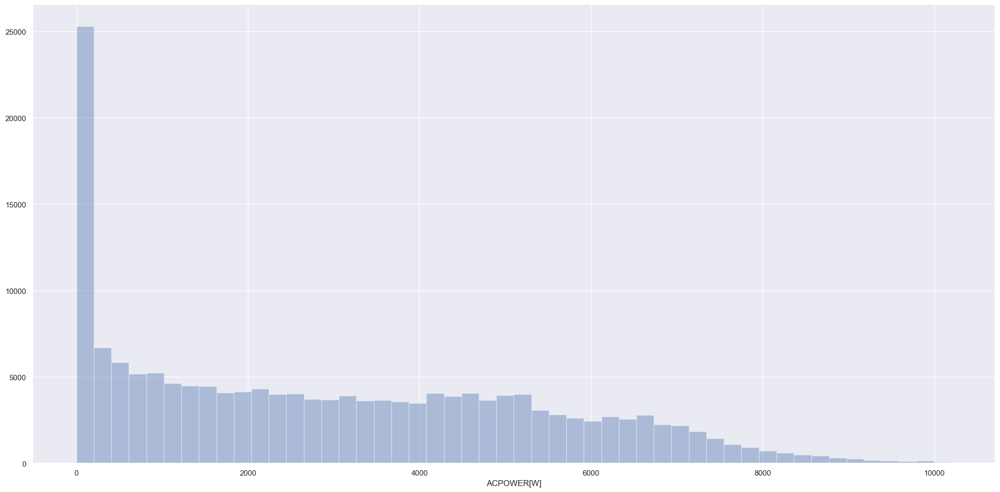

In [773]:
sns.distplot(df4['ACPOWER[W]'], kde=False);

### 4.1.2 Numerical Variable

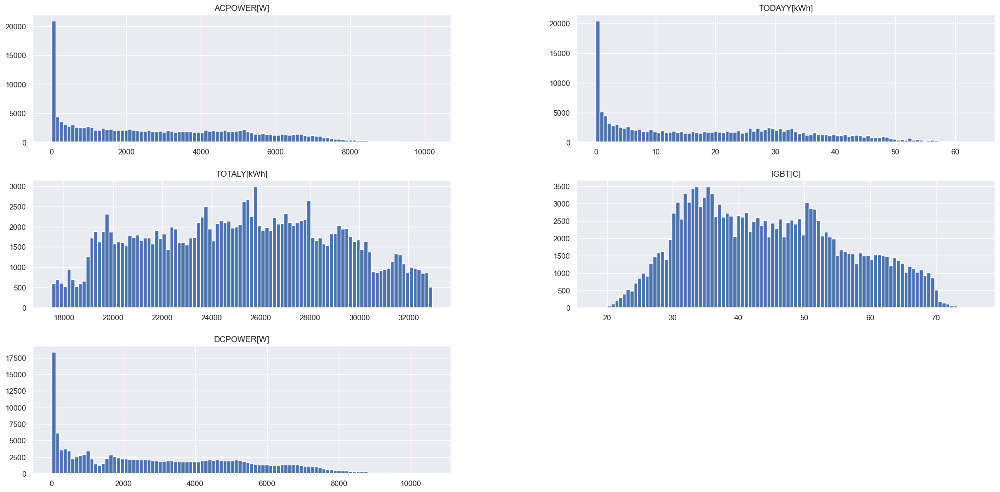

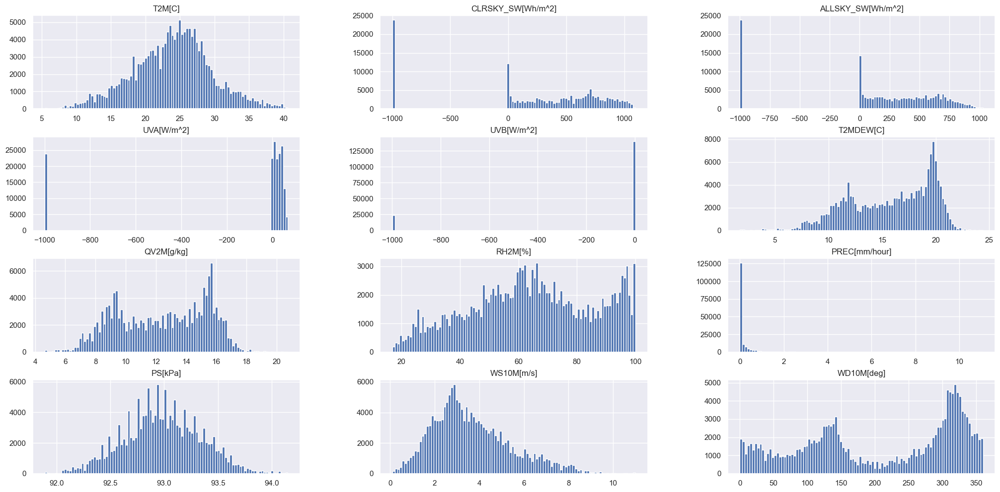

In [774]:
num_attributes = df4.select_dtypes(include = ['int64', 'float64'])
num_attributes[['ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]']].hist(bins=100);
num_attributes[['T2M[C]', 'CLRSKY_SW[Wh/m^2]', 'ALLSKY_SW[Wh/m^2]', 'UVA[W/m^2]', 'UVB[W/m^2]', 'T2MDEW[C]', 'QV2M[g/kg]', 'RH2M[%]', 'PREC[mm/hour]', 'PS[kPa]', 'WS10M[m/s]', 'WD10M[deg]']].hist(bins=100);

### 4.1.3 Geração AC x DC

In [775]:
fig = go.Figure(layout = layout)
fig.add_trace(go.Histogram(histfunc="avg", y=df1["DCPOWER[W]"], x=df4["DateTime"], name="Potência DC"))
fig.add_trace(go.Histogram(histfunc="avg", y=df1["ACPOWER[W]"], x=df4["DateTime"], name="Potência AC"))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.5)

fig.update_yaxes(title_text='Potência média (W)')

Perdas média:  96.97484722939437


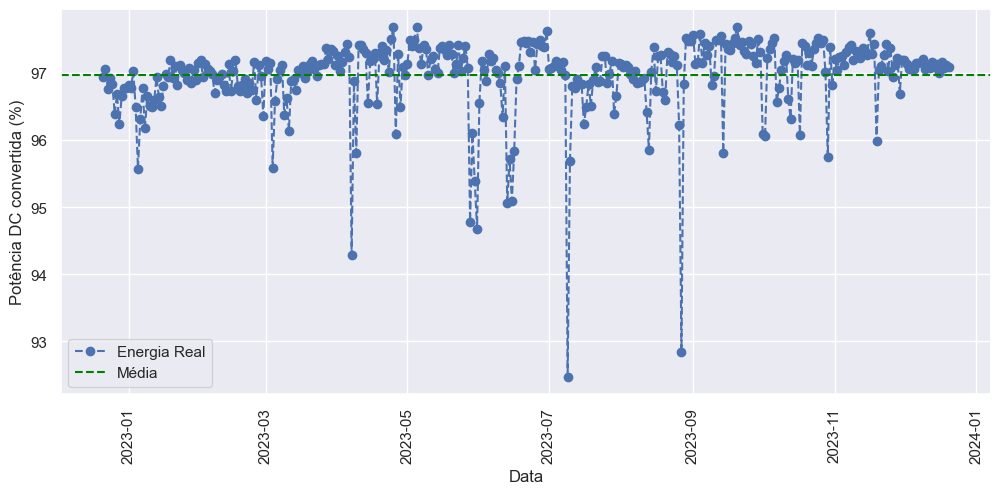

In [776]:
# Perdas na geração de energia
perdas=df4.copy() # Copia conteúdo da tabela de dados da planta
perdas=perdas[['ACPOWER[W]', 'DCPOWER[W]', 'DATE']].groupby('DATE').sum() # Agrupa todos os dados para as 34 datas
perdas['perdas']=perdas['ACPOWER[W]']/perdas['DCPOWER[W]']*100 # Reune os dados de energia real convertida

perdas['perdas'].plot(style='o--',figsize=(12,5),label='Energia Real') # Plota os dados de energia real convertida

print('Perdas média: ', perdas['perdas'].mean())

plt.ylabel('Potência DC convertida (%)',fontsize=12)
plt.xlabel('Data',fontsize=12)
plt.axhline(perdas['perdas'].mean(),linestyle='--',color='green',label='Média') # Plota linha com a média dos dados de energia convertida
plt.xticks(rotation = 90)
plt.legend()
plt.show();

### 4.1.4 Irradiação

In [777]:
# Irradiação média gerada em um período de 6 horas
fig = go.Figure(layout = layout)
fig = px.histogram(df4, labels={"DateTime": "Data"}, x="DateTime", y="ALLSKY_SW[Wh/m^2]", histfunc='avg')
fig.update_yaxes(title_text='Irradiação média (Wh/m²)')

### 4.1.5 Temperatura

In [778]:
fig = go.Figure(layout = layout)
fig.add_trace(go.Histogram(histfunc="avg", y=df1['IGBT[C]'], x=df4['DateTime'], name="IGBT"))
fig.add_trace(go.Histogram(histfunc="avg", y=df1['T2M[C]'], x=df4['DateTime'], name="Temp Ambiente"))

fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.5)

fig.update_yaxes(title_text='Temperatura média (ºC)')

### 4.1.6 Geração Horária

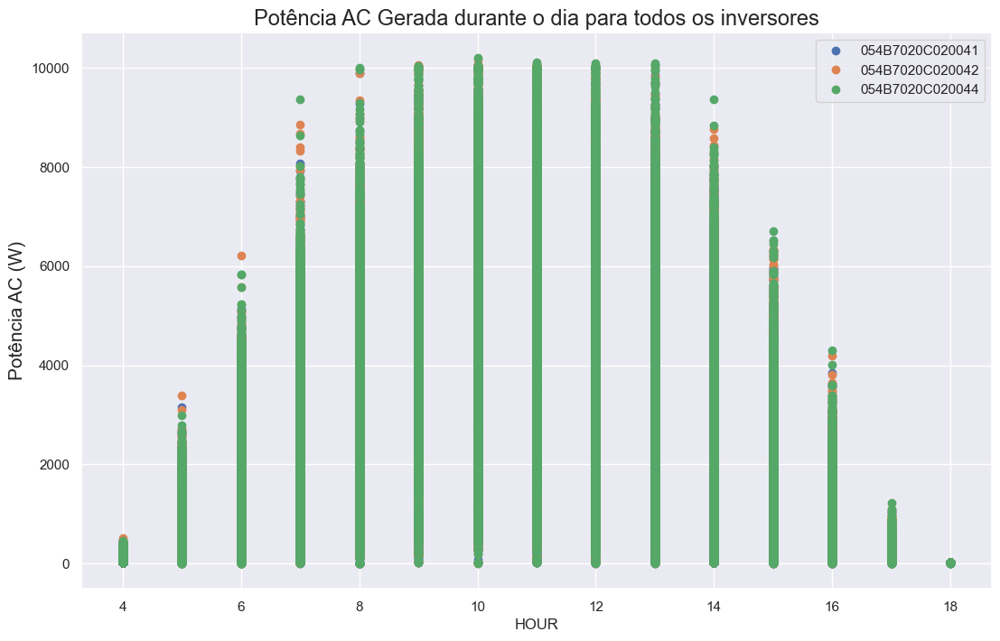

In [779]:
inversores = df4.copy()
inversores.set_index('HOUR').groupby('INVERTER')['ACPOWER[W]'].plot(style='o', legend=True, figsize=(13,8))

plt.title('Potência AC Gerada durante o dia para todos os inversores', size=17)
plt.ylabel('Potência AC (W)', fontsize=15)
plt.legend()
plt.show()

In [780]:
# Removendo intervalo onde a geração de enegia é nula
filtro = (df4['DateTime'].dt.hour > 4) & (df4['DateTime'].dt.hour < 17)
df4 = df4[filtro]

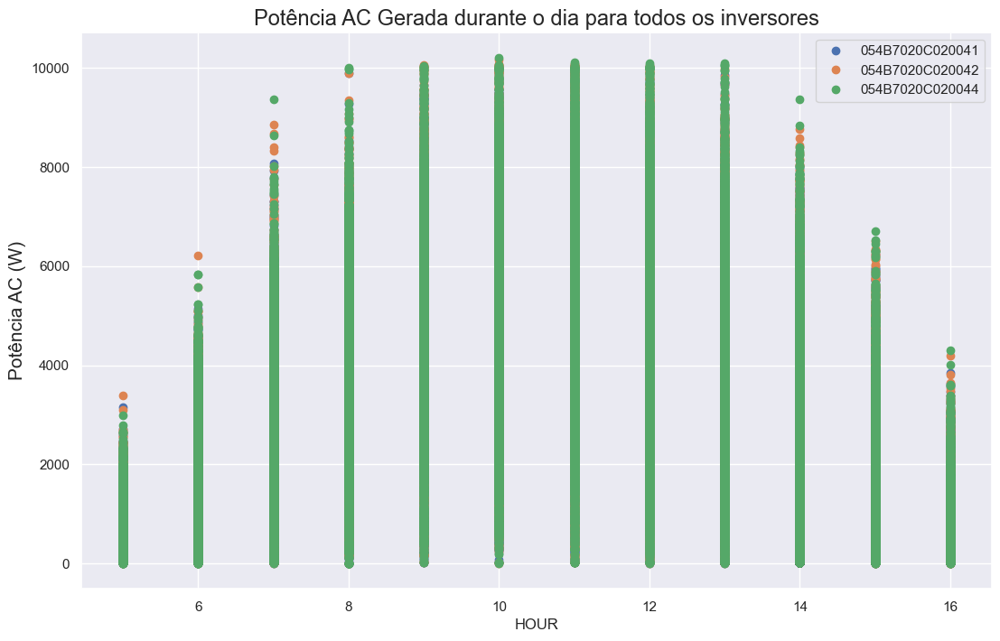

In [781]:
# gráfico sem os dados de geração nula
inversores = df4.copy()
inversores.set_index('HOUR').groupby('INVERTER')['ACPOWER[W]'].plot(style='o', legend=True, figsize=(13,8))

plt.title('Potência AC Gerada durante o dia para todos os inversores', size=17)
plt.ylabel('Potência AC (W)', fontsize=15)
plt.legend()
plt.show()

### 4.1.7 Verificação de valores nulos de geração

In [782]:
# Reunir os valores nulos de energia
dataframe = df4.copy()
filtro = df4['ACPOWER[W]'] == 0

geracaoACNula = dataframe[filtro]

# Histograma com as quantidade de valores nulos 
diasNulos = geracaoACNula['HOUR']

fig = px.histogram(geracaoACNula, labels={"x": "Data"}, x=diasNulos, y="ACPOWER[W]", histfunc='count')
fig.update_yaxes(title_text='Quantidade de valores nulos')

In [783]:
# Histograma com a média de irradiação para quando a geração de energia foi nula
diasNulos = geracaoACNula['HOUR']

fig = go.Figure(layout = layout)
fig = px.histogram(geracaoACNula, labels={'x': "Hora"}, x=diasNulos, y="ALLSKY_SW[Wh/m^2]", histfunc='avg')
fig.update_yaxes(title_text='Irradiação solar média para os valores nulos (Wh/m²)')

### 4.1.8 Geração dos 7 dias para cada inversor

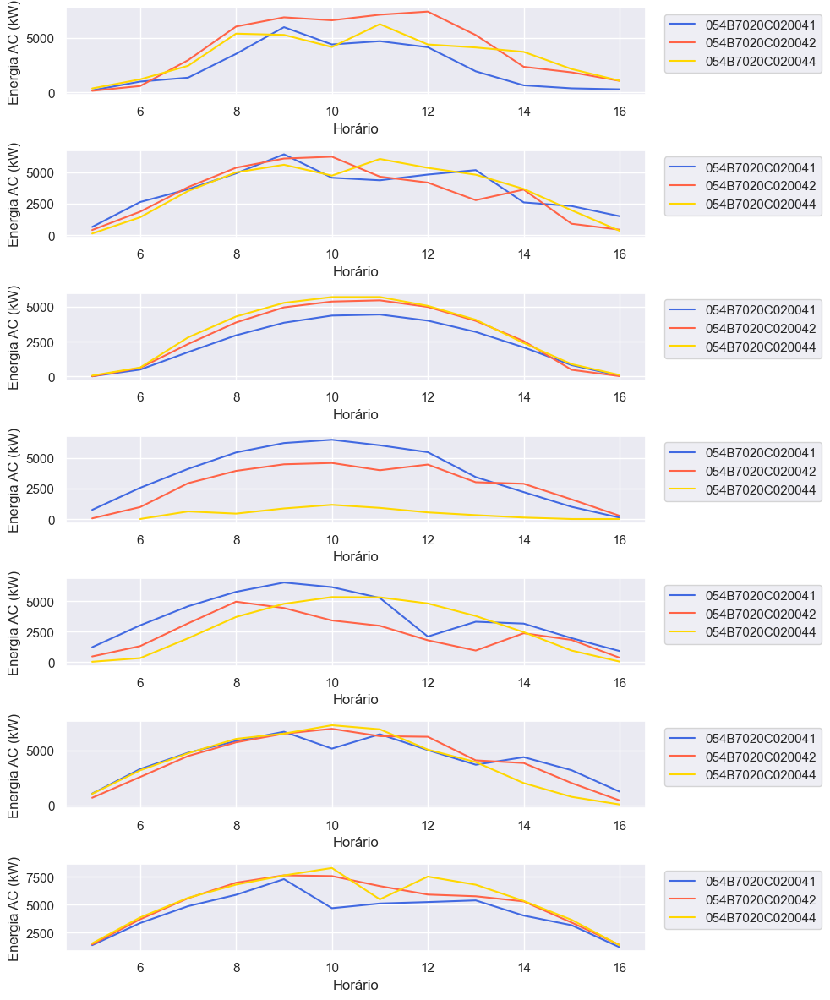

In [784]:
geracao = df4.copy()

# Ensure 'DateTime' is in datetime format
geracao['DateTime'] = pd.to_datetime(geracao['DateTime'])

# Extract date and hour from 'DateTime'
geracao['Data'] = geracao['DateTime'].dt.date
geracao['Horário'] = geracao['DateTime'].dt.hour

inversores = ['054B7020C020041', '054B7020C020042', '054B7020C020044']
cores = ['royalblue', 'tomato', 'gold']

# Convert string to datetime.date
date_limit = datetime.datetime.strptime('2023-12-21', '%Y-%m-%d').date()

fig, ax = plt.subplots(7, 1, figsize=(10, 12))

for i, inversor in enumerate(inversores):
    # Use date_limit in your condition
    dados_inversor = geracao.loc[geracao['INVERTER'] == inversor].loc[geracao['Data'] < date_limit]
    # Select 7 random days
    unique_dates = dados_inversor['Data'].unique()
    random_dates = np.random.choice(unique_dates, size=7, replace=False)
    dados_inversor = dados_inversor[dados_inversor['Data'].isin(random_dates)]
    
    for j, date in enumerate(sorted(random_dates)):
        dados_inversor[dados_inversor['Data'] == date].groupby('Horário')['ACPOWER[W]'].mean().plot(ax=ax[j], color=cores[i])

for a in ax:
    a.set_ylabel('Energia AC (kW)')
    a.legend(inversores, bbox_to_anchor=(1.02, 1))

plt.tight_layout()
plt.show()

### 4.1.9 Outliers

In [785]:
def boxplot_individuais(data, colunas, largura = 10, altura = 8):
    fig = plt.figure()
    fig.subplots_adjust(hspace = 0.4, wspace = 0.4)
    fig.set_figheight(altura)
    fig.set_figwidth(largura)
    
    ajusteColunas = math.ceil(len(colunas) / 2)
    
    for i, coluna in enumerate(colunas):
        ax = fig.add_subplot(ajusteColunas, 2, i + 1)
        sns.boxplot(x = data[coluna])
        
    plt.tight_layout()
    plt.show()

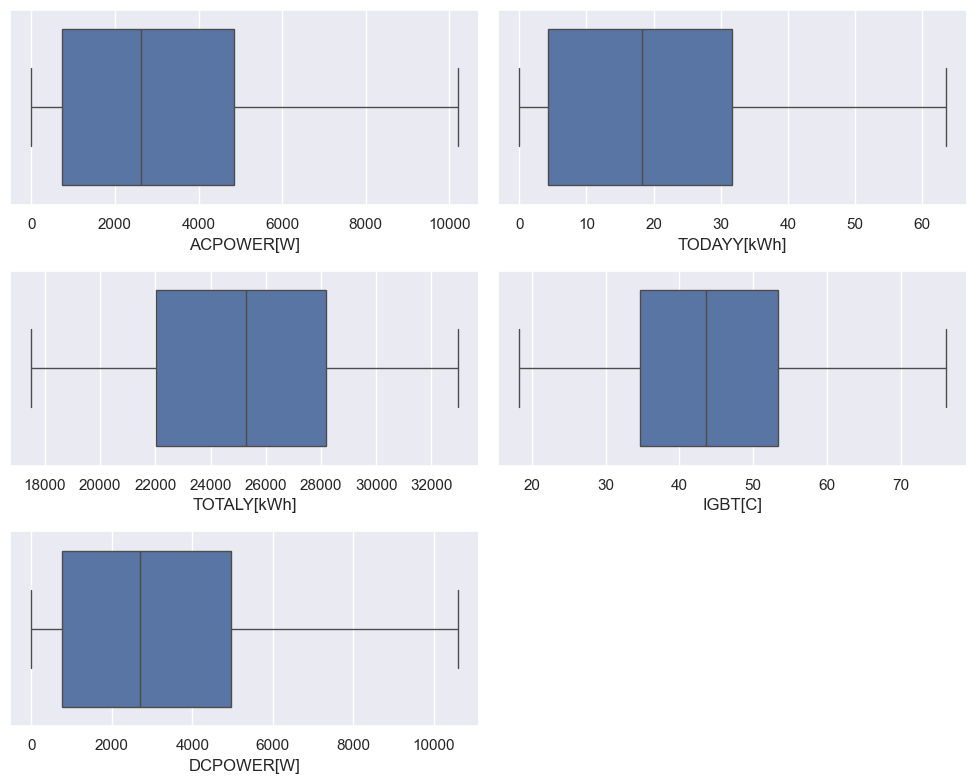

In [786]:
# Retira valores qualitativos da amostra (Data e número de identificação dos inversores)
quantitativos = df4.drop(['INVERTER', 'DateTime', 'DATE', 'YEAR', 'MONTH', 'DAY', 'HOUR', 'MIN', 'DAY_WEEK', 'WEEK_YEAR'], axis = 1).columns

boxplot_individuais(df1, quantitativos[0:5])

## 4.2 Análise Multivariada

### 4.2.1 Correlação

In [787]:
# Verifique se as colunas existem
assert set(['INVERTER', 'ACPOWER[W]']).issubset(df4.columns), "Some columns are missing in the DataFrame"

In [788]:
# Trate valores ausentes
df41 = df4.loc[df4['INVERTER'] == '054B7020C020041'].dropna()

In [789]:
# Converta colunas de data/hora para formato numérico
for col in df41.select_dtypes(include=['object']).columns:
    try:
        df41[col] = pd.to_datetime(df41[col])
        df41[col] = df41[col].apply(lambda x: x.toordinal())
    except ValueError:
        pass

In [790]:
# Calcule a correlação
corr_matrix = df41.drop('INVERTER', axis=1).corr()

In [791]:
# Exiba a correlação com 'ACPOWER[W]'
print(corr_matrix["ACPOWER[W]"].sort_values(ascending=False))

ACPOWER[W]             1.000000
DCPOWER[W]             0.999887
IGBT[C]                0.857371
T2M[C]                 0.335946
T2MWET                 0.300692
ALLSKY_SW[Wh/m^2]      0.164617
CLRSKY_SW[Wh/m^2]      0.142836
TODAYY[kWh]            0.115461
WD10M[deg]             0.101531
WD50M                  0.094338
T2MDEW[C]              0.087852
QV2M[g/kg]             0.086857
ALLSKY_KT              0.054854
ALLSKY_SRF_ALB         0.054696
PS[kPa]                0.045381
WS10M[m/s]             0.037323
ALLSKY_SFC_PAR_TOT     0.034762
SZA                    0.034570
WEEK_YEAR              0.030809
CLRSKY_SFC_PAR_TOT     0.025784
MONTH                  0.025151
TOTALY[kWh]            0.006092
DATE                   0.005218
DateTime               0.005145
DAY_WEEK              -0.009681
DAY                   -0.016891
YEAR                  -0.032062
HOUR                  -0.055083
PREC[mm/hour]         -0.086301
WS50M                 -0.102318
UVA[W/m^2]            -0.119899
ALLSKY_S

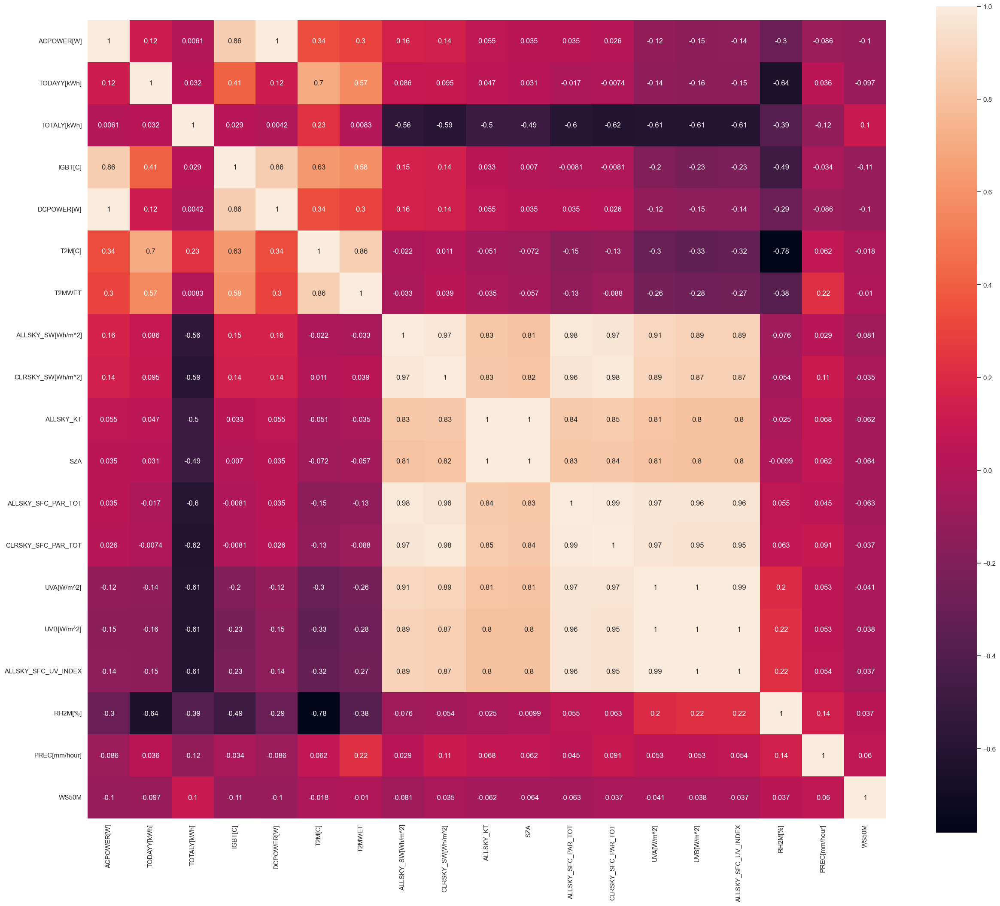

In [792]:
fig, ax = plt.subplots(figsize=(30, 25))  # Ajuste o tamanho conforme necessário

sns.heatmap(df41.drop(['QV2M[g/kg]','T2MDEW[C]','WD50M','ALLSKY_SRF_ALB','WD10M[deg]','PS[kPa]', 'WS10M[m/s]','INVERTER', 'DateTime', 'DATE', 'YEAR', 'MONTH', 'DAY', 'HOUR', 'MIN', 'DAY_WEEK', 'WEEK_YEAR'], axis=1).corr(method = 'pearson'), annot = True, square = True, ax=ax)

plt.show()


# 5.0 DATA PREPARATION

In [793]:
# A partir desse ponto apenas o dataset do inversor 054B7020C020041 será utilizado para treinar o algoritmo
df5 = df4.copy()
filtro41 = (df5['INVERTER'] == '054B7020C020041')
filtro42 = (df5['INVERTER'] == '054B7020C020042')
filtro44 = (df5['INVERTER'] == '054B7020C020044')
df5.head()

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,WS50M,WD50M,DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
27,400.0,0.1,17510.0,30.0,480.0,054B7020C020041,2022-12-21 05:00:00,16.26,15.65,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
28,460.0,0.1,18990.0,28.9,445.0,054B7020C020044,2022-12-21 05:00:00,16.26,15.65,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
29,460.0,0.1,18899.0,29.6,468.0,054B7020C020042,2022-12-21 05:00:00,16.26,15.65,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
30,550.0,0.2,17510.0,30.4,563.0,054B7020C020041,2022-12-21 05:00:00,16.26,15.65,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
31,560.0,0.1,18990.0,29.4,522.0,054B7020C020044,2022-12-21 05:00:00,16.26,15.65,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0


## 5.1 Split dataframe into training and test dataset

In [794]:
# # Supondo que 'df5' seja o seu DataFrame completo e 'filtro41' seja uma condição booleana
# df_filtered = df5[filtro41]

# # Dividindo os dados em conjuntos de treino e teste com embaralhamento
# df_train, df_test = train_test_split(df_filtered, test_size=0.2, random_state=42, shuffle=True)

# print('Training Min Date: {}'.format(df_train['DateTime'].min()))
# print('Training Max Date: {}'.format(df_train['DateTime'].max()))

# print('\nTest Min Date: {}'.format(df_test['DateTime'].min()))
# print('Test Max Date: {}'.format(df_test['DateTime'].max()))

# training dataset - inicialmente 80/20
df_train = df5[filtro41][df5[filtro41]['DateTime'] < '2023-12-14']

# test dataset
#df_test = df5[df5['DateTime'] >= '2021-10-06']
df_test_41 = df5[filtro41][df5[filtro41]['DateTime'] >= '2023-12-14']
df_test_42 = df5[filtro42][df5[filtro42]['DateTime'] >= '2023-12-14']
df_test_44 = df5[filtro44][df5[filtro44]['DateTime'] >= '2023-12-14']

print('Training Min Date: {}'.format(df_train['DateTime'].min()))
print('Training Max Date: {}'.format(df_train['DateTime'].max()))

print('\nTest Date Min Date: {}'.format(df_test_41['DateTime'].min()))
print('Test Max Date: {}'.format(df_test_41['DateTime'].max()))

Training Min Date: 2022-12-21 05:00:00
Training Max Date: 2023-12-13 16:00:00

Test Date Min Date: 2023-12-14 05:00:00
Test Max Date: 2023-12-20 16:00:00


## 5.2 Standardization

In [795]:
ss = pp.StandardScaler()

## 5.3 Rescaling

In [796]:
mms = pp.MinMaxScaler()
mms_y = pp.MinMaxScaler()

In [797]:
def RescalingMMS(df):
    """
    Função para aplicar o escalonamento MinMaxScaler em um dataframe.

    Argumentos:
        df: Dataframe a ser escalonado.

    Retorna:
        Dataframe com as colunas escalonadas.
    """
    # Verificação de colunas vazias
    for col in df.columns:
        if df[col].isnull().sum() == df.shape[0]:
            raise ValueError(f"Coluna '{col}' possui apenas valores nulos.")

    # Escalonamento das colunas
    df['ACPOWER[W]']  = mms_y.fit_transform(df[['ACPOWER[W]']].values)
    df['TODAYY[kWh]'] = mms_y.fit_transform(df[['TODAYY[kWh]']].values)
    df['TOTALY[kWh]'] = mms_y.fit_transform(df[['TOTALY[kWh]']].values)
    df['IGBT[C]']     = mms_y.fit_transform(df[['IGBT[C]']].values)
    df['DCPOWER[W]']  = mms_y.fit_transform(df[['DCPOWER[W]']].values)
    df['T2M[C]']      = mms_y.fit_transform(df[['T2M[C]']].values)
    df['CLRSKY_SW[Wh/m^2]'] = mms_y.fit_transform(df[['CLRSKY_SW[Wh/m^2]']].values)
    df['ALLSKY_SW[Wh/m^2]'] = mms_y.fit_transform(df[['ALLSKY_SW[Wh/m^2]']].values)
    df['UVA[W/m^2]'] = mms_y.fit_transform(df[['UVA[W/m^2]']].values)
    df['UVB[W/m^2]'] = mms_y.fit_transform(df[['UVB[W/m^2]']].values)
    df['T2MDEW[C]'] = mms_y.fit_transform(df[['T2MDEW[C]']].values)
    df['QV2M[g/kg]'] = mms_y.fit_transform(df[['QV2M[g/kg]']].values)
    df['RH2M[%]'] = mms_y.fit_transform(df[['RH2M[%]']].values)
    df['PREC[mm/hour]'] = mms_y.fit_transform(df[['PREC[mm/hour]']].values)
    df['PS[kPa]'] = mms_y.fit_transform(df[['PS[kPa]']].values)
    df['WS10M[m/s]'] = mms_y.fit_transform(df[['WS10M[m/s]']].values)

    return df


In [798]:
RescalingMMS(df_train)
RescalingMMS(df_test_41)
RescalingMMS(df_test_42)
RescalingMMS(df_test_44)
RescalingMMS(df5)

,ACPOWER[W],TODAYY[kWh],TOTALY[kWh],IGBT[C],DCPOWER[W],INVERTER,DateTime,T2M[C],T2MDEW[C],T2MWET,...,WS50M,WD50M,DATE,YEAR,MONTH,WEEK_YEAR,DAY_WEEK,DAY,HOUR,MIN
27,0.039216,0.001577,0.000000,0.202422,0.045296,054B7020C020041,2022-12-21 05:00:00,0.307561,0.621429,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
28,0.045098,0.001577,0.095811,0.183391,0.041993,054B7020C020044,2022-12-21 05:00:00,0.307561,0.621429,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
29,0.045098,0.001577,0.089920,0.195502,0.044163,054B7020C020042,2022-12-21 05:00:00,0.307561,0.621429,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
30,0.053922,0.003155,0.000000,0.209343,0.053128,054B7020C020041,2022-12-21 05:00:00,0.307561,0.621429,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
31,0.054902,0.001577,0.095811,0.192042,0.049259,054B7020C020044,2022-12-21 05:00:00,0.307561,0.621429,15.96,...,6.55,152.12,2022-12-21,2022,12,51,3,21,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
172111,0.063725,0.894322,1.000000,0.382353,0.062187,054B7020C020044,2023-12-20 16:00:00,0.750142,0.484375,22.21,...,8.87,140.65,2023-12-20,2023,12,51,3,20,16,0
172112,0.059804,0.875394,0.991260,0.377163,0.061716,054B7020C020042,2023-12-20 16:00:00,0.750142,0.484375,22.21,...,8.87,140.65,2023-12-20,2023,12,51,3,20,16,0
172113,0.050980,0.826498,0.825403,0.377163,0.054072,054B7020C020041,2023-12-20 16:00:00,0.750142,0.484375,22.21,...,8.87,140.65,2023-12-20,2023,12,51,3,20,16,0
172114,0.050000,0.894322,1.000000,0.371972,0.042370,054B7020C020044,2023-12-20 16:00:00,0.750142,0.484375,22.21,...,8.87,140.65,2023-12-20,2023,12,51,3,20,16,0


## 5.4 Nature Transformation

In [799]:
def time_transform(df):
    df['month_sin'] = df['MONTH'].apply(lambda x: np.sin(x * (2 * np.pi/12)))
    df['month_cos'] = df['MONTH'].apply(lambda x: np.cos(x * (2 * np.pi/12)))

    df['week_of_year_sin'] = df['WEEK_YEAR'].apply(lambda x: np.sin(x * (2 * np.pi/52)))
    df['week_of_year_cos'] = df['WEEK_YEAR'].apply(lambda x: np.cos(x * (2 * np.pi/52)))

    df['day_of_week_sin'] = df['DAY_WEEK'].apply(lambda x: np.sin(x * (2 * np.pi/7)))
    df['day_of_week_cos'] = df['DAY_WEEK'].apply(lambda x: np.cos(x * (2 * np.pi/7)))

    df['day_sin'] = df['DAY'].apply(lambda x: np.sin(x * (2 * np.pi/30)))
    df['day_cos'] = df['DAY'].apply(lambda x: np.cos(x * (2 * np.pi/30)))

    df['hour_sin'] = df['HOUR'].apply(lambda x: np.sin(x * (2 * np.pi/24)))
    df['hour_cos'] = df['HOUR'].apply(lambda x: np.cos(x * (2 * np.pi/24)))

    df['minute_sin'] = df['MIN'].apply(lambda x: np.sin(x * (2 * np.pi/60)))
    df['minute_cos'] = df['MIN'].apply(lambda x: np.cos(x * (2 * np.pi/60)))

    cols_drop = ['MONTH', 'WEEK_YEAR', 'DAY_WEEK', 'DAY', 'HOUR', 'MIN', 'DATE'] # elimina as colunas
    df = df.drop(cols_drop, axis = 1, inplace=True)
    return None

### 5.4.1 Training

In [800]:
df_train = time_transform(df_train)


### 5.4.2 Test

In [801]:
# time_transform(df_test)
time_transform(df_test_41)
time_transform(df_test_42)
time_transform(df_test_44)

### 5.4.2 Complete

In [802]:
df5 = time_transform


# 6.0 FEATURE SELECTION

In [803]:
df6 = df5.copy()

## 6.1 Feature Selection df1

### 6.1.1 Target variable

In [804]:
# training dataset
y_train_41 = df_train[filtro41][['ACPOWER[W]']]

# test dataset
y_test_41 = df_test_41[['ACPOWER[W]']]

# dataset completo
y_completo_41 = df6[filtro41][['ACPOWER[W]']]

TypeError: 'NoneType' object is not subscriptable

### 6.1.2 Boruta as Feature Selector

In [ ]:
df_train.dtypes

ACPOWER[W]                    float64
TODAYY[kWh]                   float64
TOTALY[kWh]                   float64
IGBT[C]                       float64
DCPOWER[W]                    float64
INVERTER                       object
DateTime               datetime64[ns]
T2M[C]                        float64
T2MDEW[C]                     float64
T2MWET                        float64
QV2M[g/kg]                    float64
ALLSKY_SW[Wh/m^2]             float64
CLRSKY_SW[Wh/m^2]             float64
ALLSKY_KT                     float64
ALLSKY_SRF_ALB                float64
SZA                           float64
ALLSKY_SFC_PAR_TOT            float64
CLRSKY_SFC_PAR_TOT            float64
UVA[W/m^2]                    float64
UVB[W/m^2]                    float64
ALLSKY_SFC_UV_INDEX           float64
RH2M[%]                       float64
PREC[mm/hour]                 float64
PS[kPa]                       float64
WS10M[m/s]                    float64
WD10M[deg]                    float64
WS50M       

In [ ]:
# training and test dataset for Boruta
# elimina variaveis de geração para não enviesar o algoritmo
X_train_n = df_train.drop(['DateTime', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER'], axis = 1).values
y_train_n = y_train_41.values.ravel() # ravel is to vetorize the values

In [ ]:
# define randomforestregressor
rf = RandomForestRegressor(n_jobs = -1)

In [ ]:
# Converta a coluna 'DateTime' para formato numérico
df['DateTime'] = pd.to_datetime(df['DateTime'], errors='coerce')
df = df.dropna(subset=['DateTime'])
df['DateTime'] = df['DateTime'].apply(lambda x: x.toordinal())

# Tente converter todas as outras colunas para numéricas
for col in df.columns:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Preencha os valores NaN com a mediana da coluna, se a mediana não for NaN; caso contrário, preencha com 0
for col in df.columns:
    median = df[col].median()
    if pd.isna(median):
        df[col] = df[col].fillna(0)
    else:
        df[col] = df[col].fillna(median)

# Agora você pode criar X_train_n e y_train_n a partir de df e ajustar o modelo
X_train_n = df.drop('ACPOWER[W]', axis=1).values
y_train_n = df['ACPOWER[W]'].values

boruta = BorutaPy(rf, n_estimators = 'auto', verbose = 2, random_state = 42).fit(X_train_n, y_train_n)


Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	27
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	5
Tentative: 	0
Rejected: 	22


BorutaPy finished running.

Iteration: 	9 / 100
Confirmed: 	5
Tentative: 	0
Rejected: 	22


### 6.2.1 Best Features from Boruta

In [ ]:
cols_selected = boruta.support_.tolist()

# best features
X_train_fs = df_train.drop(['DateTime', 'ACPOWER[W]', 'TODAYY[kWh]', 'TOTALY[kWh]', 'IGBT[C]', 'DCPOWER[W]', 'INVERTER'], axis = 1) 

In [ ]:
# print(f'Número de colunas em X_train_fs: {X_train_fs.shape[1]}')
# print(f'Tamanho de cols_selected: {len(cols_selected)}')


In [ ]:
# cols_selected = boruta.support_.tolist()

# # Use a máscara para selecionar as colunas
# cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.to_list()

In [ ]:
# cols_selected_boruta

cols_selected_boruta = ['T2M[C]',
                        'T2MDEW[C]',
                        'T2MWET',
                        'ALLSKY_SW[Wh/m^2]',
                        'CLRSKY_SW[Wh/m^2]',
                        'ALLSKY_KT',
                        'ALLSKY_SRF_ALB',
                        'SZA',
                        'UVA[W/m^2]',
                        'UVB[W/m^2]',
                        'RH2M[%]',
                        'PREC[mm/hour]',
                        'PS[kPa]',
                        'WS10M[m/s]',
                        'WS50M',
                        'week_of_year_cos',
                        'day_sin',
                        'day_cos',
                        'hour_sin',
                        'minute_sin',
                        'minute_cos']

# 7.0 MACHINE LEARNING MODELING

In [ ]:
df7 = df6.copy()

In [ ]:
x_train = df_train[cols_selected_boruta]
x_test_41  = df_test_41[cols_selected_boruta]
x_test_42  = df_test_42[cols_selected_boruta]
x_test_44  = df_test_44[cols_selected_boruta]

y_completo_41 = y_completo_41.values

KeyError: "['week_of_year_cos', 'day_sin', 'day_cos', 'hour_sin', 'minute_sin', 'minute_cos'] not in index"

## 7.1 Random Forest Regressor

In [ ]:
# # Converta a coluna 'DateTime' para formato numérico
# df['DateTime'] = pd.to_datetime(df['DateTime'], errors='coerce')
# df = df.dropna(subset=['DateTime'])
# df['DateTime'] = df['DateTime'].apply(lambda x: x.toordinal())

# # Tente converter todas as outras colunas para numéricas
# for col in df.columns:
#     df[col] = pd.to_numeric(df[col], errors='coerce')

# # Preencha os valores NaN com a mediana da coluna, se a mediana não for NaN; caso contrário, preencha com 0
# for col in df.columns:
#     median = df[col].median()
#     if pd.isna(median):
#         df[col] = df[col].fillna(0)
#     else:
#         df[col] = df[col].fillna(median)

# # Agora você pode criar X_train_n e y_train_n a partir de df e ajustar o modelo
# X_train_n = df.drop('ACPOWER[W]', axis=1).values
# y_train_n = df['ACPOWER[W]'].values

# treinamento (fit)

rf = RandomForestRegressor(n_estimators = 25, n_jobs = -1, random_state = 42).fit(X_train_n, y_train_n)


In [ ]:
# # Verifique se há algum valor em x_test_41 que ainda seja uma string
# string_values = x_test_41.applymap(lambda x: isinstance(x, str))
# if string_values.any().any():
#     print("Há valores de string em x_test_41:")
#     print(string_values.sum())


Há valores de string em x_test_41:
DateTime    10361
T2M[C]          0
dtype: int64


In [ ]:
# # Remova linhas onde 'DateTime' não pode ser convertido para uma data e hora válida
# x_test_41 = x_test_41[pd.to_datetime(x_test_41['DateTime'], errors='coerce').notna()]

# # Agora tente a conversão novamente
# x_test_41['DateTime'] = pd.to_datetime(x_test_41['DateTime']).apply(lambda x: x.toordinal())


In [ ]:

# # Converta a coluna 'DateTime' para formato numérico
# df['DateTime'] = pd.to_datetime(df['DateTime'], errors='coerce')
# df = df.dropna(subset=['DateTime'])
# df['DateTime'] = df['DateTime'].apply(lambda x: x.toordinal())

In [ ]:
# # Tente converter todas as outras colunas para numéricas
# for col in df.columns:
#     df[col] = pd.to_numeric(df[col], errors='coerce')

In [ ]:
# # Preencha os valores NaN com a mediana da coluna, se a mediana não for NaN; caso contrário, preencha com 0
# for col in df.columns:
#     median = df[col].median()
#     if pd.isna(median):
#         df[col] = df[col].fillna(0)
#     else:
#         df[col] = df[col].fillna(median)

In [ ]:
# # Agora você pode criar X_train_n e y_train_n a partir de df e ajustar o modelo
# X_train_n = df.drop('ACPOWER[W]', axis=1)
# y_train_n = df['ACPOWER[W]'].values

In [ ]:
# # Obtenha a lista de características do modelo
# feature_list = list(X_train_n.columns)

# # Verifique se cada coluna em feature_list existe em x_test_41
# feature_list = [col for col in feature_list if col in x_test_41.columns]

In [ ]:
# # Selecione apenas as características em x_test_41 que estão na lista de características do modelo
# x_test_41 = x_test_41[feature_list]

# predição (hat)
yhat_rf_41 = pd.DataFrame(rf.predict(x_test_41.values))  # hat é previsão



ValueError: X has 2 features, but RandomForestRegressor is expecting 27 features as input.

### 7.1.1 Normalized Data

In [ ]:
# performance
rf_result_41 = ml_error('Random forest Regressor', y_test_41, yhat_rf_41) # passa os valores reais e os previstos
rf_result_41

In [ ]:
y_test_41_rf = y_test_41.values
yhat_rf_41 = yhat_rf_41.values

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_rf_41[:, 0], label = 'prediction41')
sns.lineplot(x = df_test_41['DateTime'], y = y_test_41_rf[:,0], label = 'test41');

### 7.1.2 Inverse Transform

In [ ]:
# performance
rf_result = ml_error('Random forest Regressor', mms_y.inverse_transform(y_test_41), mms_y.inverse_transform(yhat_rf_41))
rf_result

In [ ]:
y_train_41_rf = y_train_41.values

In [ ]:
y_test_41_rf = mms_y.inverse_transform(y_test_41)
yhat_rf_41 = mms_y.inverse_transform(yhat_rf_41)
y_completo_41_rf = mms_y.inverse_transform(y_completo_41)
y_train_41_rf = mms_y.inverse_transform(y_train_41_rf)

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_rf_41[:,0], label = 'prediction41')
sns.lineplot(x = df_train['DateTime'], y = y_train_41_rf[:,0], label = 'treino41');

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_rf_41[:,0], label = 'prediction41')
sns.lineplot(x = df7[filtro41]['DateTime'], y = y_completo_41_rf[:,0], label = 'geracao41');

ValueError: array length 172161 does not match index length 10361

## 7.2 Linear Regression Model

In [ ]:
# model
lr = LinearRegression().fit(x_train, y_train_41)

In [ ]:
# prediction
yhat_lr_41 = pd.DataFrame(lr.predict(x_test_41))

### 7.2.1 Normalized Data

In [ ]:
# performance
lr_result_41 = ml_error('Linear Regression', y_test_41, yhat_lr_41)
lr_result_41

,Model Name,MAE,MAPE,RMSE
0,Linear Regression,0.13664,3.509425e+12,0.170082


In [ ]:
y_test_41_lr = y_test_41.values
yhat_lr_41 = yhat_lr_41.values

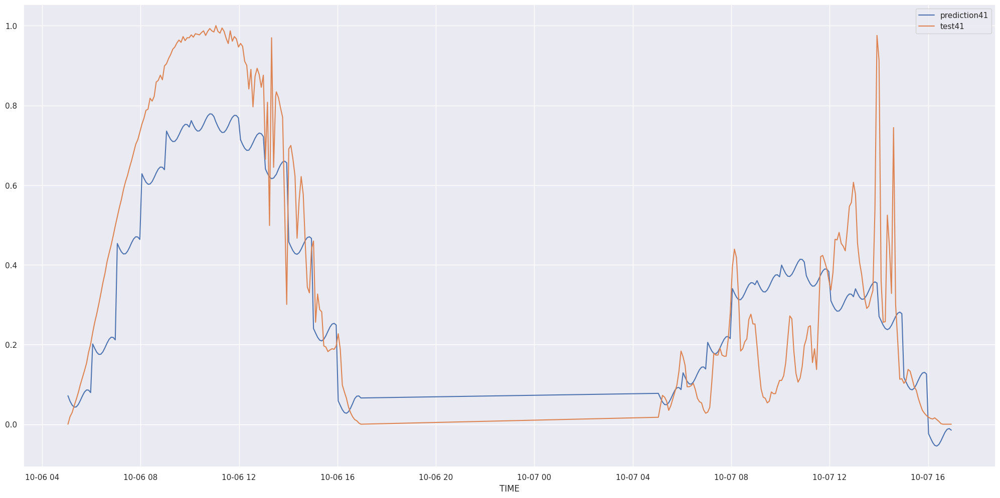

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_lr_41[:, 0], label = 'prediction41')
sns.lineplot(x = df_test_41['DateTime'], y = y_test_41_lr[:,0], label = 'test41');

### 7.2.2 Inverse Transform

In [ ]:
# performance
lr_result = ml_error('Linear Regression', mms_y.inverse_transform(y_test_41), mms_y.inverse_transform(yhat_lr_41))
lr_result

,Model Name,MAE,MAPE,RMSE
0,Linear Regression,1.109514,0.347183,1.381069


In [ ]:
y_train_41_lr = y_train_41.values

In [ ]:
y_test_41_lr = mms_y.inverse_transform(y_test_41)
yhat_lr_41 = mms_y.inverse_transform(yhat_lr_41)
y_completo_41_lr= mms_y.inverse_transform(y_completo_41)
y_train_41_lr = mms_y.inverse_transform(y_train_41_lr)

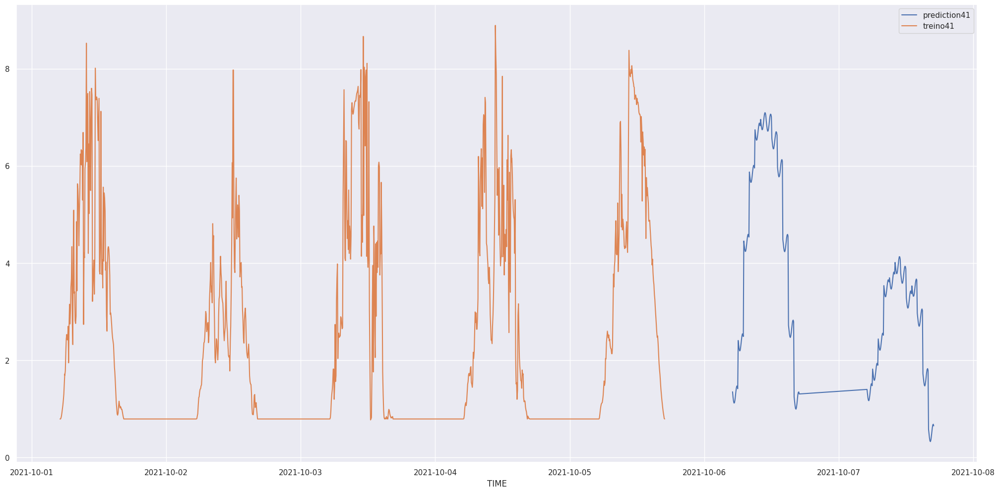

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_lr_41[:,0], label = 'prediction41')
sns.lineplot(x = df_train['DateTime'], y = y_train_41_lr[:,0], label = 'treino41');

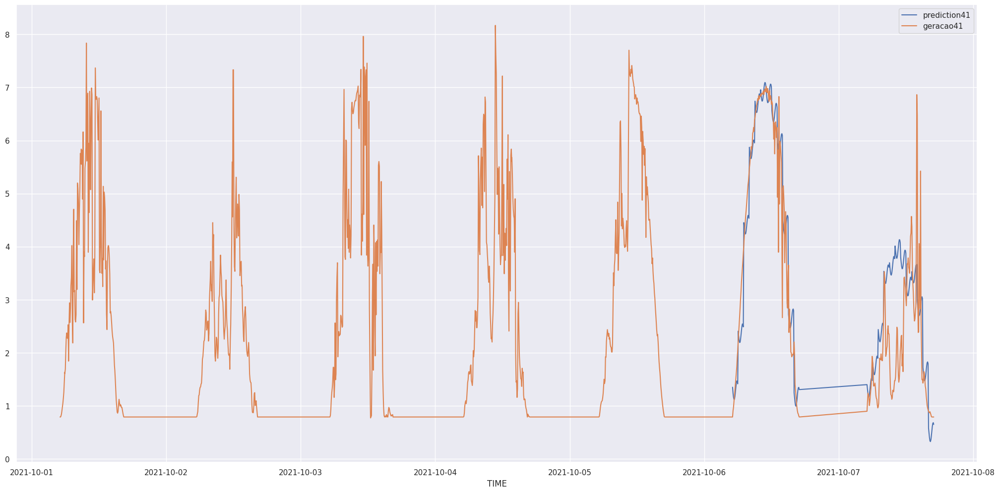

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_lr_41[:,0], label = 'prediction41')
sns.lineplot(x = df7[filtro41]['DateTime'], y = y_completo_41_lr[:,0], label = 'geracao41');

## 7.3 Decision Tree Regressor

In [ ]:
# model
dt = DecisionTreeRegressor().fit(x_train, y_train_41)

In [ ]:
# prediction
yhat_dt_41 = pd.DataFrame(dt.predict(x_test_41))

### 7.3.1 Normalized Data

In [ ]:
# performance
dt_result_41 = ml_error('Decision Tree Regressor', y_test_41, yhat_dt_41)
dt_result_41

,Model Name,MAE,MAPE,RMSE
0,Decision Tree Regressor,0.17178,2.635864e+11,0.243482


In [ ]:
y_test_41_dt = y_test_41.values
yhat_dt_41 = yhat_dt_41.values

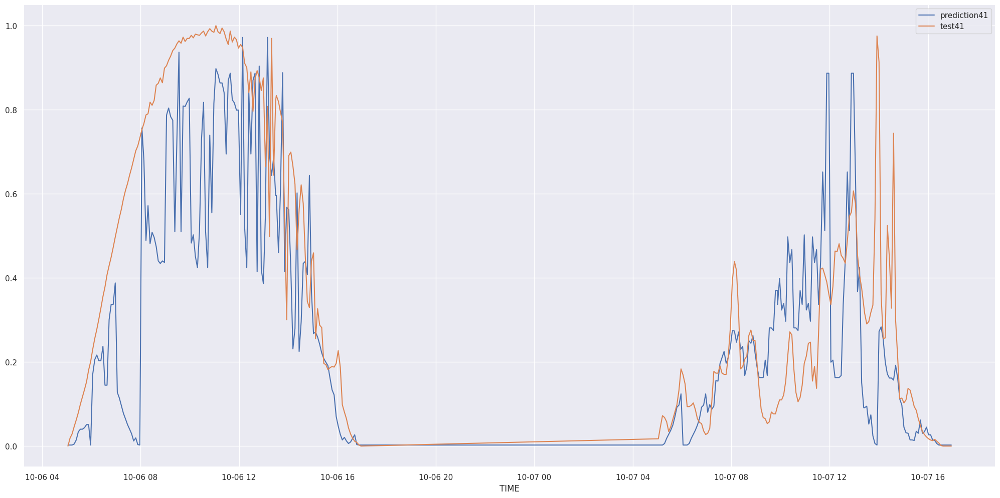

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_dt_41[:, 0], label = 'prediction41')
sns.lineplot(x = df_test_41['DateTime'], y = y_test_41_dt[:,0], label = 'test41');

### 7.3.2 Inverse Transform

In [ ]:
# performance
dt_result = ml_error('Decision Tree Regressor', mms_y.inverse_transform(y_test_41), mms_y.inverse_transform(yhat_dt_41))
dt_result

,Model Name,MAE,MAPE,RMSE
0,Decision Tree Regressor,1.394853,0.35133,1.97707


In [ ]:
y_train_41_dt = y_train_41.values

In [ ]:
y_test_41_dt = mms_y.inverse_transform(y_test_41)
yhat_dt_41 = mms_y.inverse_transform(yhat_dt_41)
y_completo_41_dt = mms_y.inverse_transform(y_completo_41)
y_train_41_dt = mms_y.inverse_transform(y_train_41_dt)

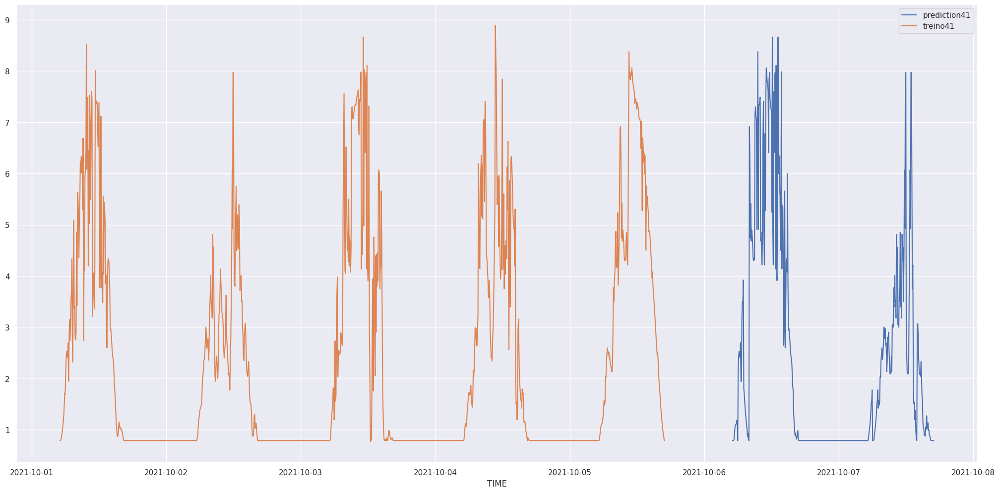

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_dt_41[:,0], label = 'prediction41')
sns.lineplot(x = df_train['DateTime'], y = y_train_41_dt[:,0], label = 'treino41');

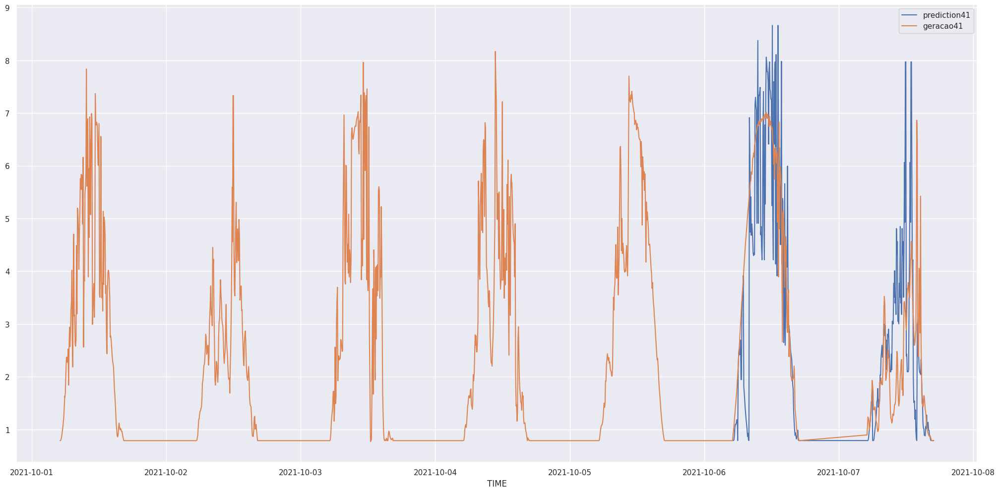

In [ ]:
sns.lineplot(x = df_test_41['DateTime'], y = yhat_dt_41[:,0], label = 'prediction41')
sns.lineplot(x = df7[filtro41]['DateTime'], y = y_completo_41_dt[:,0], label = 'geracao41');

# cross validation